In [1]:
import os
from utils import read_csv_data, extract_columns

csv_file = os.path.join("..", "data", "fig3b_multilevel.csv")

# Create a platform-independent path to the output directory
output_directory = os.path.join("..", "output", "sound")

# Ensure the directory exists
os.makedirs(output_directory, exist_ok=True)

df = read_csv_data(csv_file)
df.head()

"microseconds,",optical_contrast
f64,f64
0.015,-0.49255
0.0175,-0.493301
0.02,-0.66178
0.0225,-0.704971
0.025,-0.772267


In [7]:
import polars as pl
import numpy as np

# Calculate the Euclidean distance between consecutive points in 2D space
# For the first value, we'll use 0 as there's no previous point to compare with
df_with_dist = df.with_columns([
    (
        (pl.col("microseconds,").diff() ** 2 + 
         pl.col("optical_contrast").diff() ** 2).sqrt()
    ).fill_null(0).alias("_euclidean_distance")
])

# Display the dataframe with the new column
print("DataFrame with Euclidean distance between consecutive points:")
df_with_dist.head(10)


DataFrame with Euclidean distance between consecutive points:


"microseconds,",optical_contrast,_euclidean_distance
f64,f64,f64
0.015,-0.49255,0.0
0.0175,-0.493301,0.00261
0.02,-0.66178,0.168498
0.0225,-0.704971,0.043263
0.025,-0.772267,0.067343
0.0275,-1.074763,0.302506
0.03,-1.300248,0.225499
0.0325,-1.33319,0.033037
0.035,-1.899173,0.565988


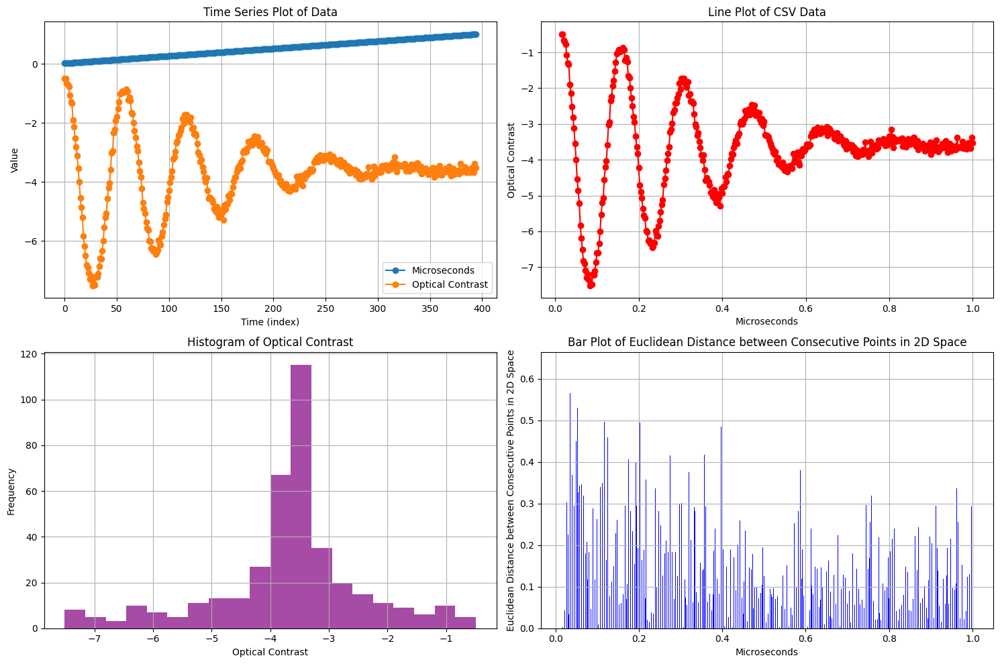

In [10]:
import matplotlib.pyplot as plt
from visualize import plot_data

# Create a figure with subplots in a grid layout
plt.figure(figsize=(15, 10))

# Get the data from the CSV file
data = extract_columns(read_csv_data(csv_file))
if data:
    x_vals, y_vals = zip(*data)
    
    # Time Series Plot
    plt.subplot(2, 2, 1)
    time_index = list(range(len(x_vals)))
    plt.plot(time_index, x_vals, marker='o', label='Microseconds')
    plt.plot(time_index, y_vals, marker='o', label='Optical Contrast')
    plt.xlabel('Time (index)')
    plt.ylabel('Value')
    plt.title('Time Series Plot of Data')
    plt.legend()
    plt.grid(True)

    # Line plot
    plt.subplot(2, 2, 2)
    plt.plot(x_vals, y_vals, marker='o', color='red')
    plt.xlabel('Microseconds')
    plt.ylabel('Optical Contrast')
    plt.title('Line Plot of CSV Data')
    plt.grid(True)
    
    # Histogram for Y (optical contrast)
    plt.subplot(2, 2, 3)
    plt.hist(y_vals, bins=20, color='purple', alpha=0.7)
    plt.xlabel('Optical Contrast')
    plt.ylabel('Frequency')
    plt.title('Histogram of Optical Contrast')
    plt.grid(True)

    # Bar plot of the difference between consecutive optical contrast values
    plt.subplot(2, 2, 4)
    plt.bar(df_with_dist.get_column("microseconds,").to_numpy(), df_with_dist.get_column("_euclidean_distance").to_numpy(), color='blue', width=0.001)
    plt.xlabel('Microseconds')
    plt.ylabel('Euclidean Distance between Consecutive Points in 2D Space')
    plt.title('Bar Plot of Euclidean Distance between Consecutive Points in 2D Space')
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()
    
else:
    print("No valid data found in CSV file.")


In [4]:
from strategies import STRATEGY_MAP, generate_audio_file

for strategy_name in STRATEGY_MAP.keys():
    output_file = os.path.join(output_directory, f"{strategy_name}.wav")
    generate_audio_file(csv_file, strategy_name=strategy_name, output_file=output_file)


Audio file generated and saved as ../output/sound/sine.wav.
Audio file generated and saved as ../output/sound/phase_mod.wav.
Audio file generated and saved as ../output/sound/chord.wav.


In [5]:
import IPython.display as ipd
import wave
import numpy as np

# Path to the sine wave audio file
wave_path = os.path.join(output_directory, "sine.wav")

# Open and display the sine wave audio
with wave.open(wave_path, 'rb') as wf:
    # Get basic info about the wave file
    n_channels = wf.getnchannels()
    sample_width = wf.getsampwidth()
    framerate = wf.getframerate()
    n_frames = wf.getnframes()
    
    # Print audio file information
    print(f"Channels: {n_channels}")
    print(f"Sample Width: {sample_width} bytes")
    print(f"Frame Rate: {framerate} Hz")
    print(f"Number of Frames: {n_frames}")
    print(f"Duration: {n_frames / framerate:.2f} seconds")

# Display audio player in the notebook
ipd.Audio(wave_path)


Channels: 1
Sample Width: 2 bytes
Frame Rate: 44100 Hz
Number of Frames: 8709750
Duration: 197.50 seconds


/Users/roryscott/Code/projects/rabi-oscillation-sonification/.venv/lib/python3.12/site-packages/matplotlib/axes/_axes.py:8264: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


Spectogram saved to ../output/sound/spectogram.png


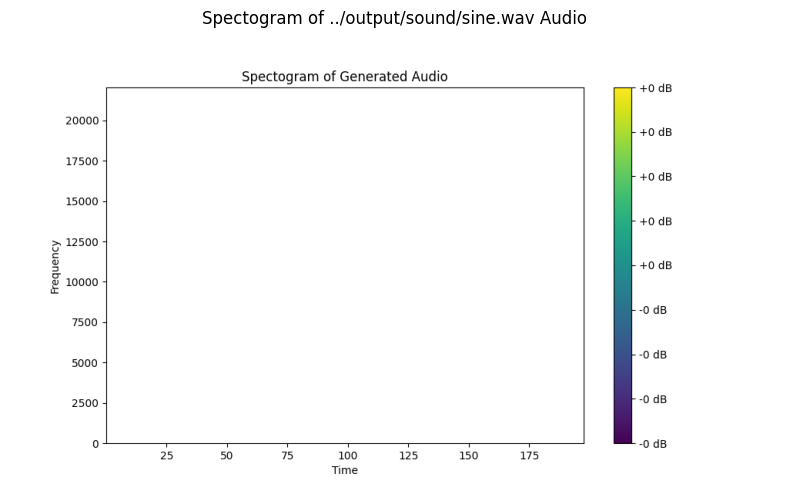

In [6]:
from visualize import plot_spectogram_of_generated_audio
import matplotlib.pyplot as plt

# Generate spectogram for the phase modulation audio file
plot_spectogram_of_generated_audio(wave_path, output_directory)

# Display the spectogram in the notebook
spectogram_path = os.path.join(output_directory, 'spectogram.png')
plt.figure(figsize=(10, 6))
img = plt.imread(spectogram_path)
plt.imshow(img)
plt.axis('off')
plt.title(f'Spectogram of {wave_path} Audio')
plt.show()
